## E-OBS temperature and precipitation data (Chapter 5)
The notebook outputs show example geographic maps and causal changepoints for the locations/years.

In [3]:

%load_ext autoreload
%autoreload 2


import os, sys
import re
from pathlib import Path

from src.exp.exp_stime.data_hypparams import RIVER_RESULT_LINKS, RIVER_NMS, PATH_RIVER_OUT, PATH_RIVER_BASINSINFO, \
    PATH_PRE, RIVER_MAINYEAR
from src.exp.exp_stime.exp_realworld import cluster_loc_yr, cps_search_locs
import src.exp.exp_stime.utils.plot_timeseries as stp
from tigramite.toymodels import structural_causal_processes as toys
import tigramite.plotting as tp
from src.exp.exp_stime.data_preproc import get_river_data
from matplotlib import pyplot as plt

sys.path.insert(0, os.path.abspath("../.."))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [16]:
from src.exp.exp_stime.data_hypparams import PATH_RIVER_LOC_INFO

# Hyperparameters, data, causal graph
links = RIVER_RESULT_LINKS
n_n = len(RIVER_NMS)

#for node in range(n_n):
#    for (pa, lg), _, _ in links[node]: print(f"{ n_n * np.abs(lg) + pa}, {node}: { RIVER_NMS[node]}-> { RIVER_NMS[pa]}")
nodes = RIVER_NMS
edges = [#(0, 0,  "Edge_T_T"), (4, 1,  "Edge_P_P"),
         (4, 2,  "Edge_Q_P")]
out_dir = PATH_PRE + PATH_RIVER_OUT
main_yr = RIVER_MAINYEAR
loc_id_file = PATH_PRE + PATH_RIVER_LOC_INFO
info_file = PATH_PRE + PATH_RIVER_BASINSINFO

loc_yr_mon_folder = Path(PATH_PRE + PATH_RIVER_OUT) / "mdl_loc_mon_2010"
#loc_yr_mon_folder = Path(PATH_PRE + PATH_RIVER_OUT) / "mdl_loc_mon_"

year_pattern = re.compile(r"^\d+_(\d{4})_0_\d+\.csv$")
yrs = {
    m.group(1)
    for f in loc_yr_mon_folder.glob("*.csv")
    if (m := year_pattern.match(f.name))
}



In [11]:
#dinfo = get_river_data()

INFO:SPCTME-river-runoff:0: 6123150  (main year 2010)
INFO:SPCTME-river-runoff:1: 6123700  (main year 2010)
INFO:SPCTME-river-runoff:2: 6125440  (main year 2010)
INFO:SPCTME-river-runoff:3: 6125540  (main year 2010)
INFO:SPCTME-river-runoff:4: 6128100  (main year 2010)
INFO:SPCTME-river-runoff:5: 6139220  (main year 2010)
INFO:SPCTME-river-runoff:6: 6139240  (main year 2010)
INFO:SPCTME-river-runoff:7: 6139360  (main year 2010)
INFO:SPCTME-river-runoff:8: 6139640  (main year 2010)
INFO:SPCTME-river-runoff:9: 6140250  (main year 2010)
INFO:SPCTME-river-runoff:10: 6140300  (main year 2010)
INFO:SPCTME-river-runoff:11: 6140450  (main year 2010)
INFO:SPCTME-river-runoff:12: 6140480  (main year 2010)
INFO:SPCTME-river-runoff:13: 6140500  (main year 2010)
INFO:SPCTME-river-runoff:14: 6140600  (main year 2010)
INFO:SPCTME-river-runoff:15: 6140700  (main year 2010)
INFO:SPCTME-river-runoff:16: 6142120  (main year 2010)
INFO:SPCTME-river-runoff:17: 6142300  (main year 2010)
INFO:SPCTME-river-ru

Map saved to C:\Users\msara\eda_impls\causalchange\src/exp/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2010.html


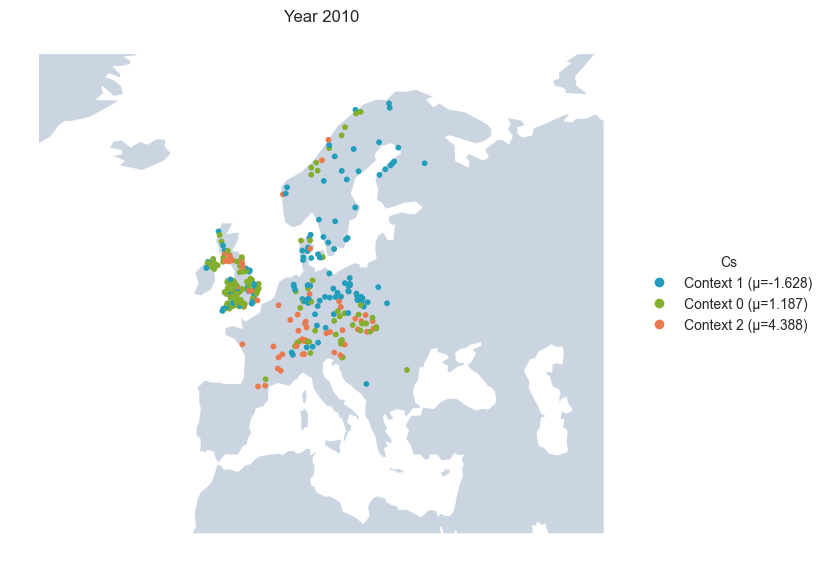

Map saved to C:\Users\msara\eda_impls\causalchange\src/exp/exp_stime/res/res_stime/river/Edge_Q_P/maps/weights_map_2010.html


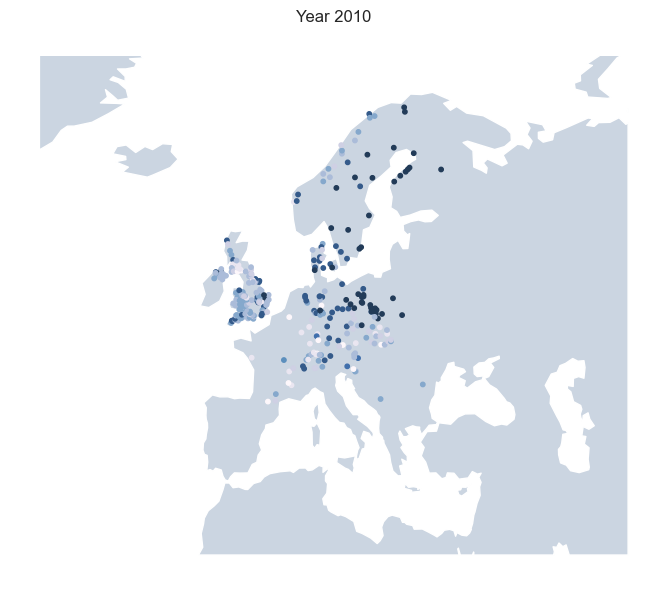

In [21]:
from src.exp.exp_stime.exp_realworld import weightmaps_loc_yr
dinfo = None
for (node_i, node_j, nm) in edges:
    cluster_loc_yr(loc_id_file, info_file, loc_yr_mon_folder, out_dir, main_yr, node_i, node_j, nm, figsize=(8,6), plt_show=True)
    weightmaps_loc_yr(loc_id_file, info_file, loc_yr_mon_folder, out_dir, main_yr, node_i, node_j, nm, figsize=(8,6), plt_show=True)

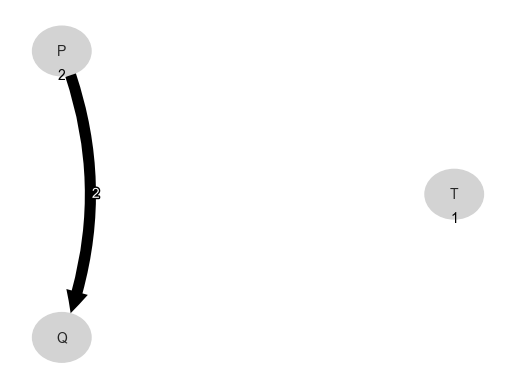

In [18]:
gt_graph = toys.links_to_graph({n: [((i, -l-1), v, f) for  ((i,l),v,f) in links[n]] for n in links}, tau_max=2)
var_names = RIVER_NMS
tp.plot_graph(
    graph=gt_graph,
    var_names=var_names,
    show_autodependency_lags=True
    ); plt.show()

## Similarity of locations
*by causal edge strength*

Map saved to C:\Users\msara\eda_impls\causalchange\src/exp/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2010.html


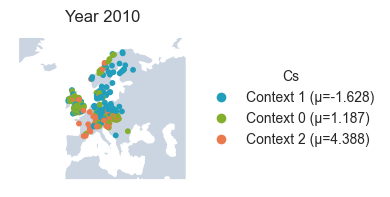

In [20]:
loc_yr_mon_folder = Path(PATH_PRE + PATH_RIVER_OUT) / f"mdl_loc_mon_{RIVER_MAINYEAR}"

for (node_i, node_j, nm) in edges:
    cluster_loc_yr(loc_id_file, info_file, loc_yr_mon_folder, out_dir, main_yr, node_i, node_j, nm, figsize=(4,4), plt_show=True)


## Changes across years

Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1950.html


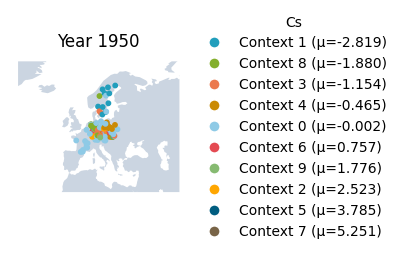

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1950.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1951.html


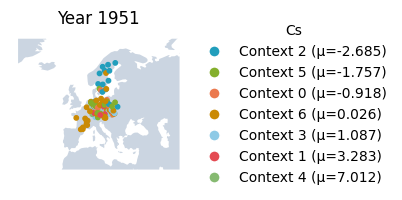

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1951.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1952.html


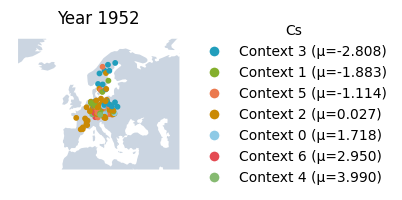

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1952.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1953.html


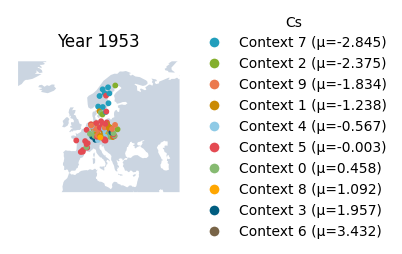

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1953.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1954.html


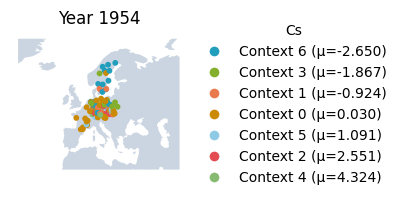

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1954.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1955.html


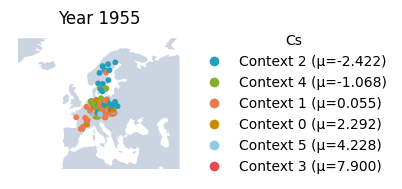

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1955.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1956.html


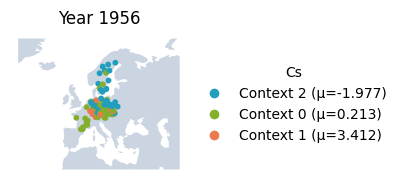

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1956.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1957.html


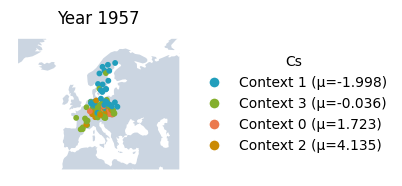

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1957.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1958.html


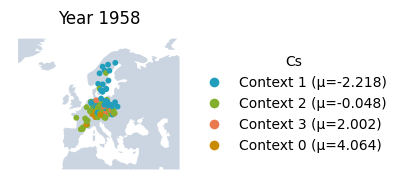

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1958.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1959.html


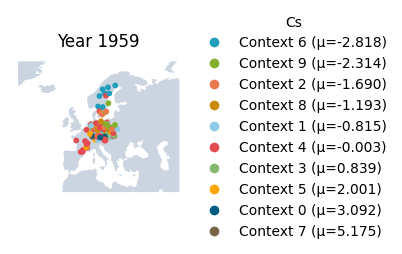

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1959.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1960.html


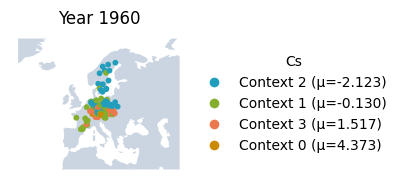

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1960.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1961.html


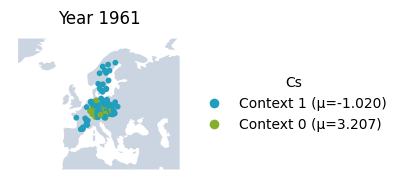

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1961.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1962.html


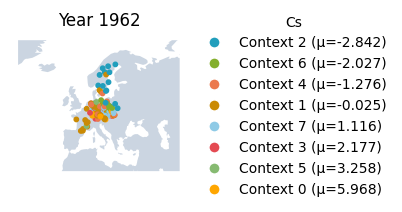

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1962.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1963.html


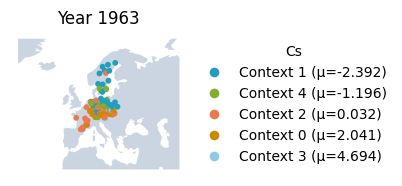

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1963.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1964.html


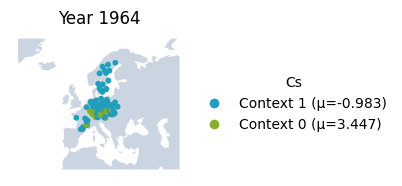

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1964.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1965.html


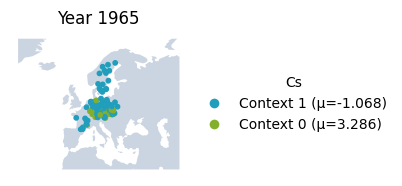

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1965.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1966.html


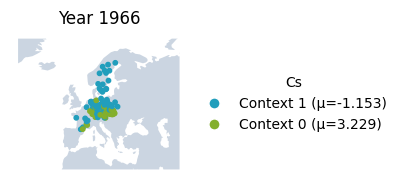

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1966.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1967.html


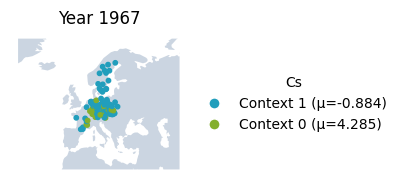

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1967.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1968.html


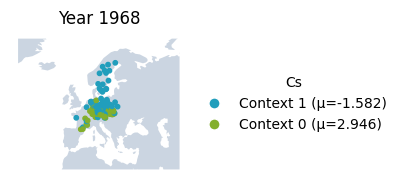

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1968.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1969.html


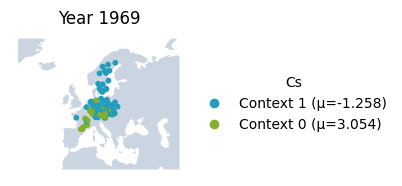

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1969.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1970.html


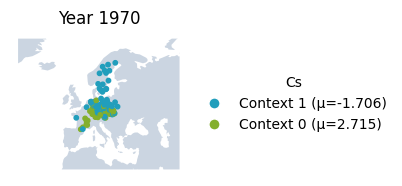

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1970.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1971.html


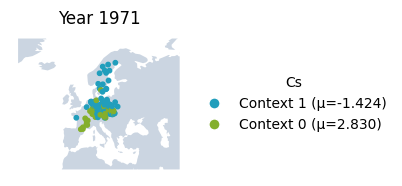

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1971.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1972.html


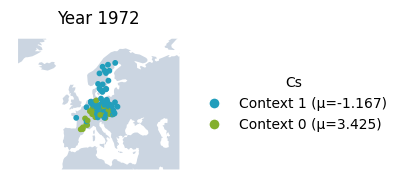

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1972.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1973.html


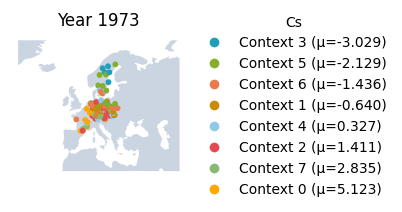

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1973.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1974.html


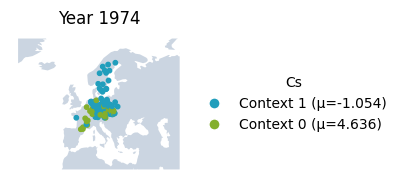

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1974.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1975.html


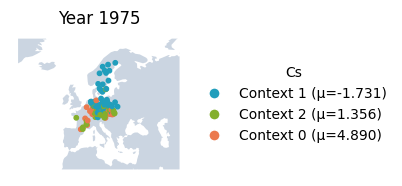

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1975.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1976.html


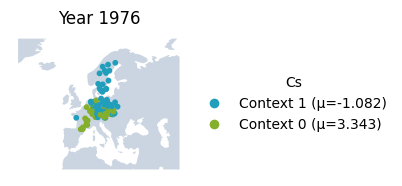

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1976.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1977.html


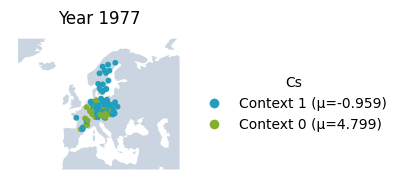

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1977.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1978.html


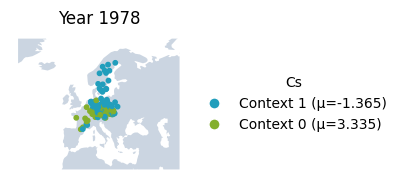

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1978.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1979.html


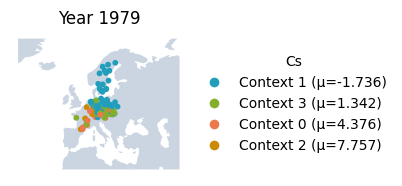

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1979.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1980.html


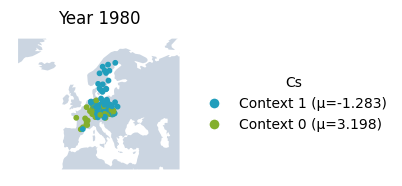

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1980.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1981.html


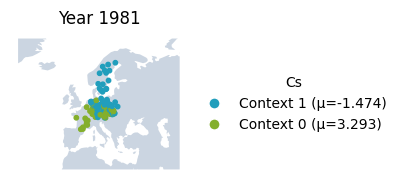

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1981.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1982.html


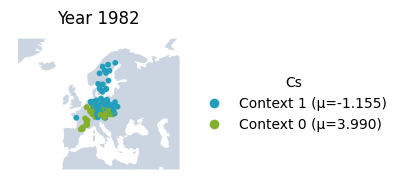

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1982.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1983.html


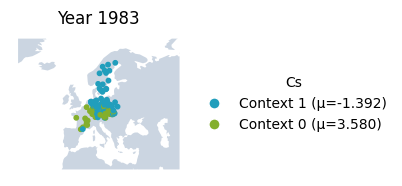

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1983.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1984.html


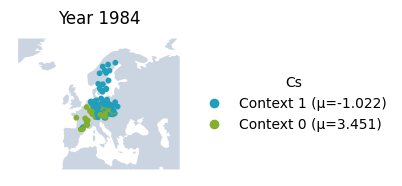

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1984.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1985.html


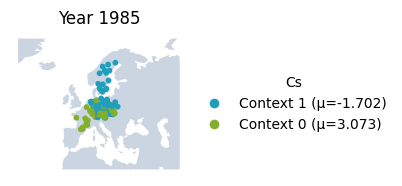

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1985.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1986.html


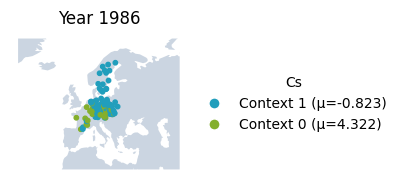

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1986.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1987.html


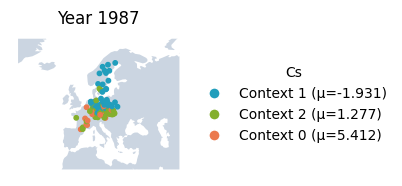

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1987.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1988.html


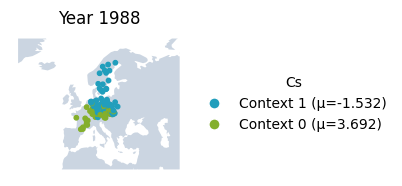

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1988.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1989.html


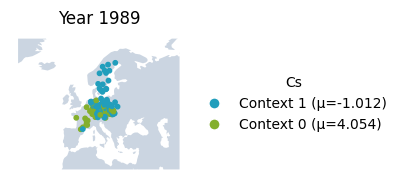

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1989.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1990.html


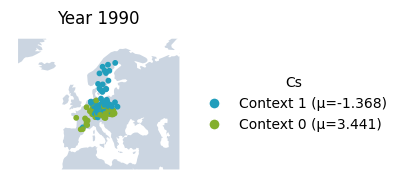

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1990.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1991.html


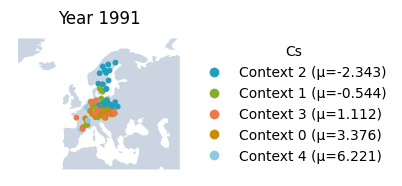

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1991.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1992.html


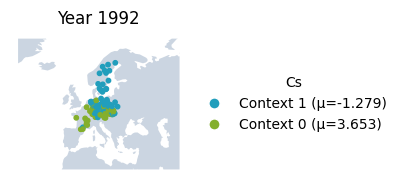

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1992.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1993.html


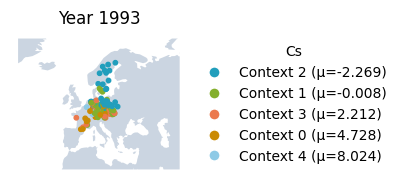

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1993.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1994.html


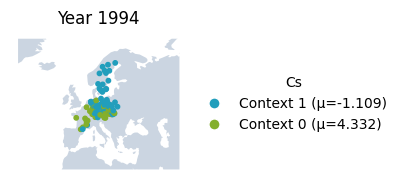

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1994.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1995.html


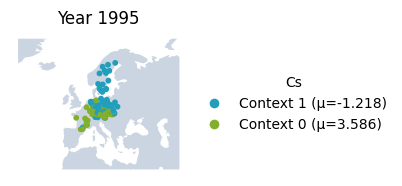

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1995.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1996.html


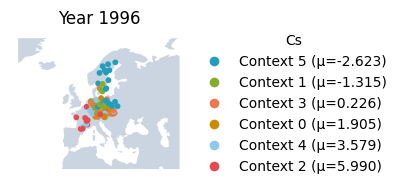

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1996.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1997.html


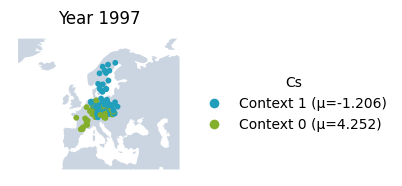

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1997.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1998.html


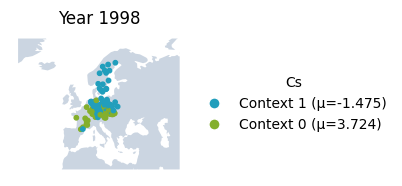

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1998.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_1999.html


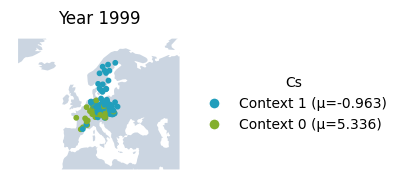

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_1999.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2000.html


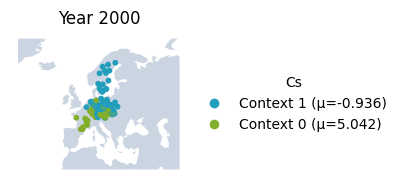

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2000.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2001.html


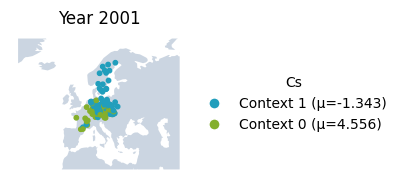

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2001.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2002.html


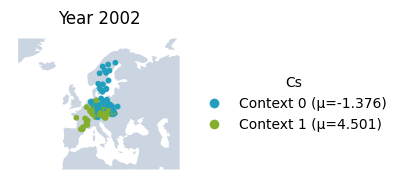

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2002.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2003.html


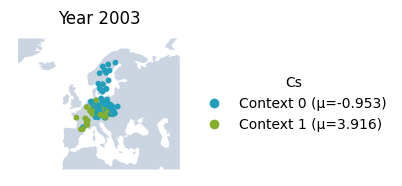

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2003.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2004.html


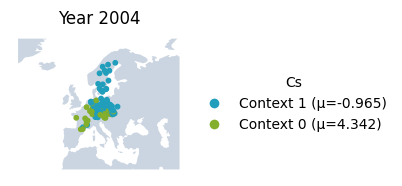

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2004.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2005.html


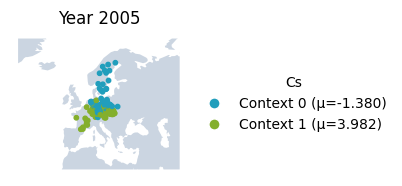

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2005.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2006.html


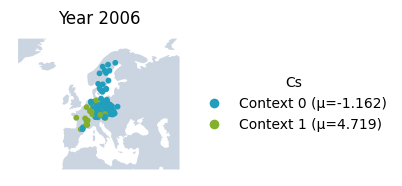

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2006.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2007.html


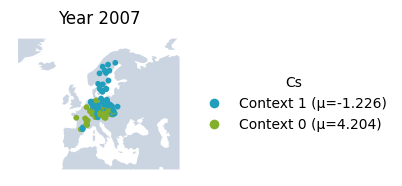

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2007.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2008.html


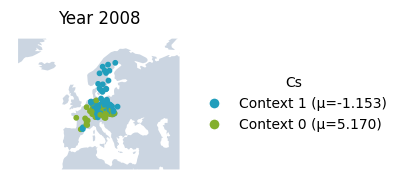

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2008.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2009.html


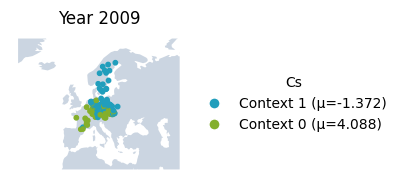

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2009.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2010.html


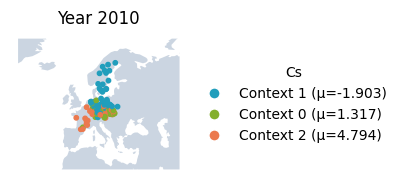

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2010.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2011.html


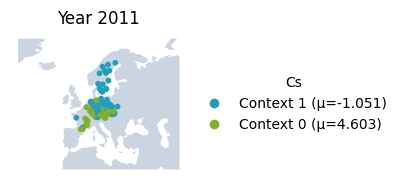

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2011.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2012.html


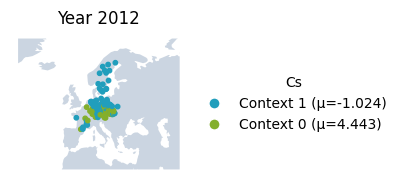

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2012.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2013.html


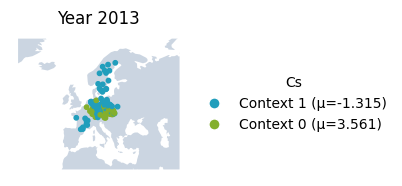

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2013.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2014.html


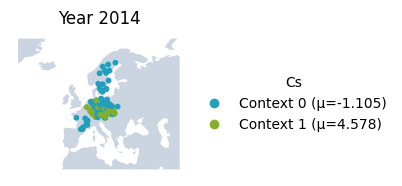

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2014.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2015.html


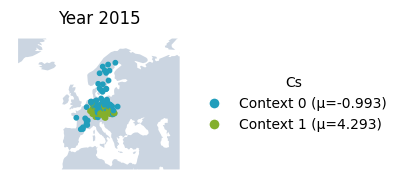

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2015.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2016.html


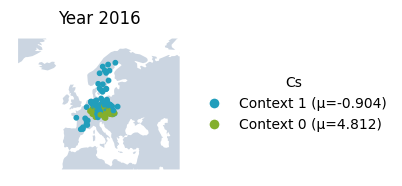

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2016.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2017.html


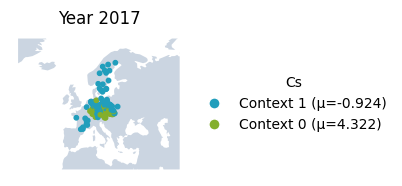

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2017.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2018.html


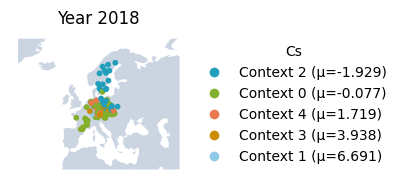

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2018.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2019.html


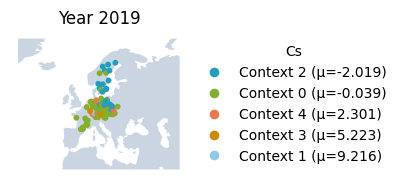

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2019.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2020.html


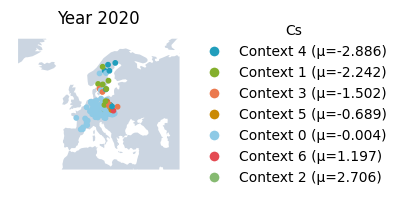

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2020.html
Map saved to C://Users\msara\eda_papers\git_thesissrc\src/exp_stime/res/res_stime/river/Edge_Q_P/maps/clusters_map_2021.html


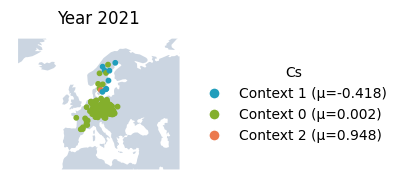

Geo map saved to C:\Users\msara\eda_papers\git_thesissrc\src\exp_stime\res\res_stime\river\Edge_Q_P\maps\clusters_map_2021.html


In [5]:
loc_yr_mon_folder = Path(PATH_PRE + PATH_RIVER_OUT) /  "mdl_loc_mon_"


year_pattern = re.compile(r"^\d+_(\d{4})_0_\d+\.csv$")
yrs = {
    m.group(1)
    for f in loc_yr_mon_folder.glob("*.csv")
    if (m := year_pattern.match(f.name))
}



for (node_i, node_j, nm) in nodes:
    for yr in sorted(yrs, key=int):
        cluster_loc_yr(loc_id_file, info_file, loc_yr_mon_folder, yr, node_i, node_j, nm)


### Changepoint detection
 *at each catchment location (year 2010)*

In [10]:
# CHANGEPOINTS PER LOCATION (2010)
links = RIVER_RESULT_LINKS
changepoints_per_loc = cps_search_locs(dinfo)


*** CPS SEARCH *** 
	Loc 6123150
	Result:
	changepts: 7, regimes: 5 
	CPS: [(0, 75, 0.0), (75, 63, 1.0), (138, 35, 2.0), (173, 37, 3.0), (210, 45, 4.0), (255, 64, 2.0), (319, 46, 0.0)]
	Contexts: [0.]
	Regimes/node: {0: array([0., 0., 0., 0., 0., 0., 0.]), 1: array([0., 0., 0., 0., 0., 0., 0.]), 2: array([0., 1., 2., 3., 4., 2., 0.])}
	Contexts/node: {0: array([0.]), 1: array([0.]), 2: array([0.])}
*** CPS SEARCH *** 
	Loc 6123700
	Result:
	changepts: 7, regimes: 6 
	CPS: [(0, 75, 0.0), (75, 64, 1.0), (139, 35, 2.0), (174, 30, 3.0), (204, 35, 4.0), (239, 46, 5.0), (285, 80, 0.0)]
	Contexts: [0.]
	Regimes/node: {0: array([0., 0., 0., 0., 0., 0., 0.]), 1: array([0., 0., 0., 0., 0., 0., 0.]), 2: array([0., 1., 2., 3., 4., 5., 0.])}
	Contexts/node: {0: array([0.]), 1: array([0.]), 2: array([0.])}
*** CPS SEARCH *** 
	Loc 6125440
	Result:
	changepts: 5, regimes: 3 
	CPS: [(0, 175, 0.0), (175, 75, 1.0), (250, 36, 2.0), (286, 33, 1.0), (319, 46, 0.0)]
	Contexts: [0.]
	Regimes/node: {0: array(

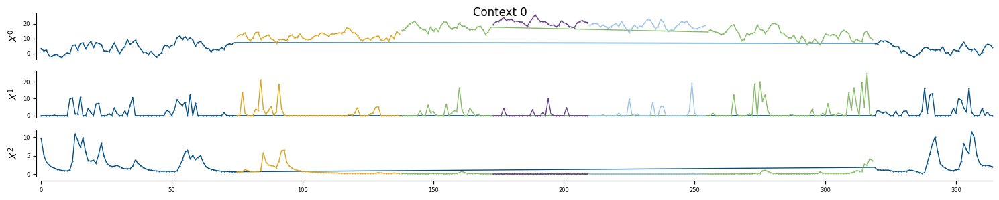

In [9]:
from types import SimpleNamespace
stp.plot_timeseries_regimes_contexts(SimpleNamespace(datasets=changepoints_per_loc[0]["data"]),  changepoints_per_loc[0]["regimes"])

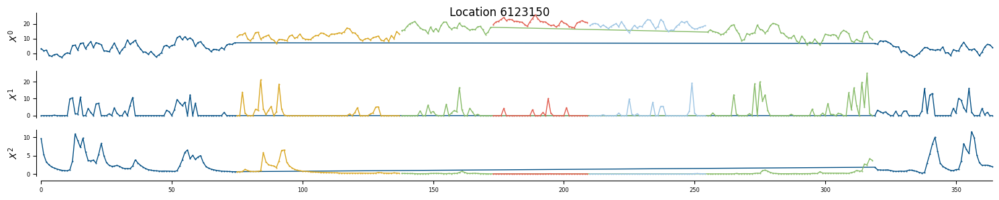

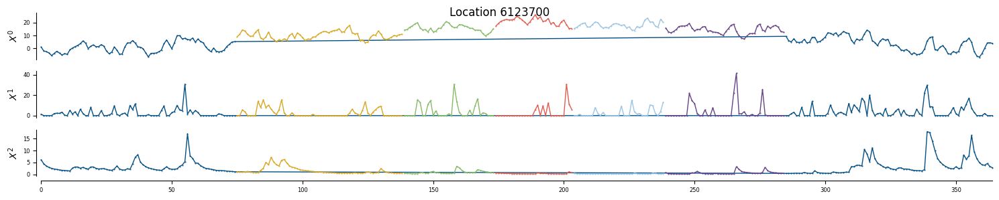

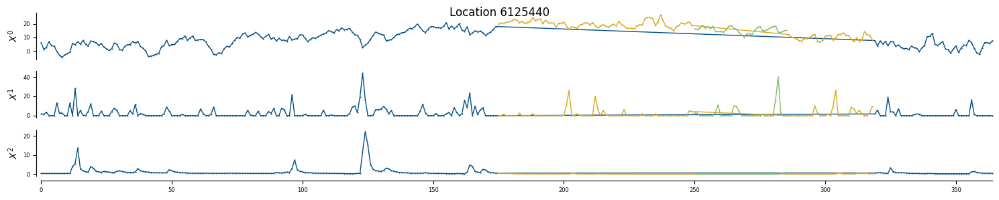

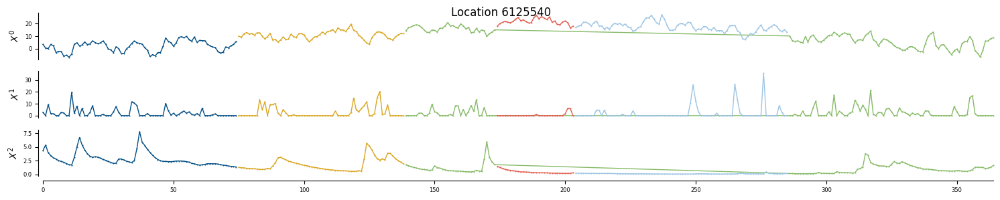

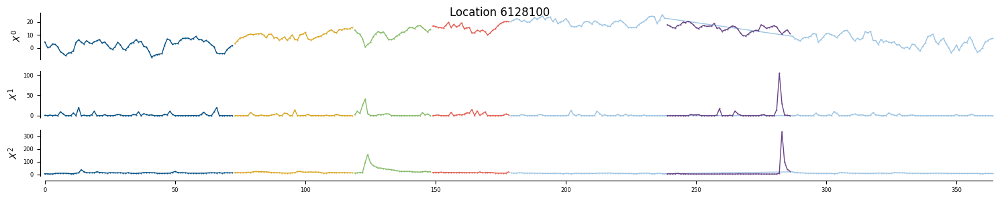

...

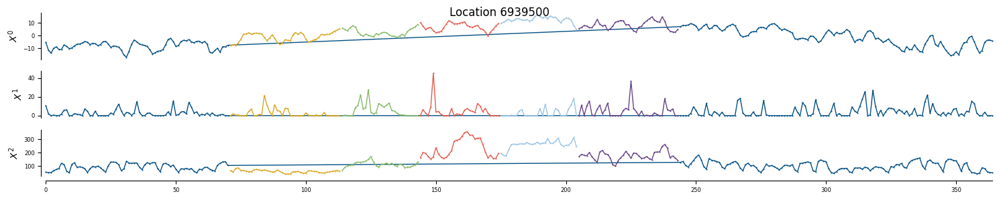

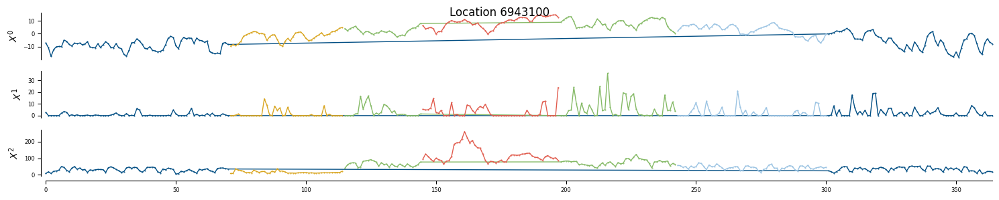

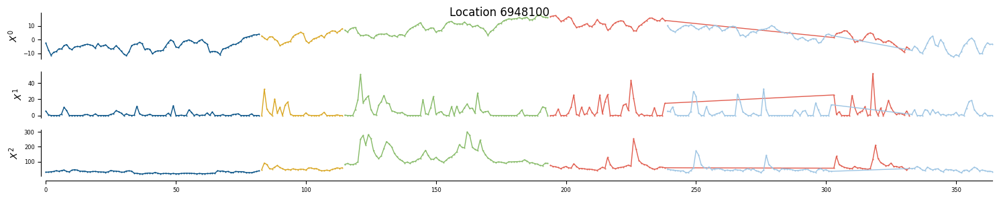

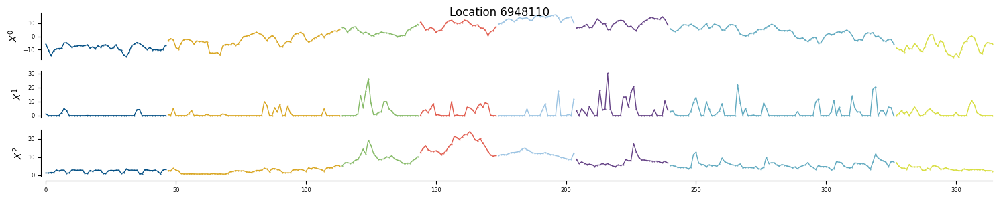

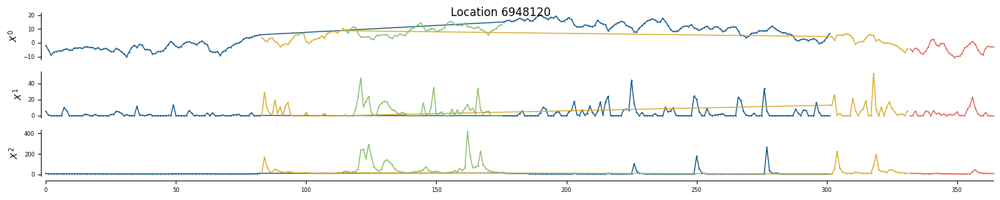

In [14]:

for loc in changepoints_per_loc:
    stp.plot_timeseries_regimes_contexts(SimpleNamespace(datasets=changepoints_per_loc[loc]["data"]),     changepoints_per_loc[loc]["regimes"], title=f"Location {dinfo['loc_ids'][loc]}")